In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from PIL import Image

In [ ]:
parent = r""

In [2]:
file = rf"{parent}\CSVs\experiment_data_02_20-20-52_speed.csv"
df = pd.read_csv(file)

file = rf"{parent}\CSVs\experiment_data_02_21-14-17_speed.csv"
df2 = pd.read_csv(file)

file = rf"{parent}\CSVs\sweeping_exp_data\experiment_data_sweeping_20240424-191451.csv"
df3 = pd.read_csv(file)

In [5]:
file = rf"{parent}\CSVs\sweeping_exp_data\experiment_data_sweeping_20240424-203652.csv"
df4 = pd.read_csv(file)

In [7]:
file = rf"{parent}\CSVs\continous_4\experiment_data_20240402-141953_continous_4.csv"
df5 = pd.read_csv(file)

In [8]:
mask_vasc = r"d:\OneDrive\OneDrive - uniroma1.it\Università\Tesi Master\Images\BW_channels\default_segmentation_vascular_large.png"
mask_vasc = Image.open(mask_vasc)

In [25]:
df = df4

In [26]:
df = df[df["state"] != 0]

In [27]:
diff = df["state"].diff()
df.loc[:, "episode"] = (diff < 0).cumsum()

C:\Users\loren\AppData\Local\Temp\ipykernel_24064\979096307.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, "episode"] = (diff < 0).cumsum()


In [28]:
for episode in range(0, int(df["episode"].max())):
    episode_df = df[df["episode"] == episode]
    dist_x = episode_df["agent_location_x"].diff()
    dist_y = episode_df["agent_location_y"].diff()
    dist = np.sqrt(dist_x**2 + dist_y**2)
    df.loc[df["episode"] == episode, "distance"] = dist

C:\Users\loren\AppData\Local\Temp\ipykernel_24064\2934335606.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[df["episode"] == episode, "distance"] = dist


In [29]:
fps = 12
df.loc[:, "speed"] = df.loc[:, "distance"] * fps

C:\Users\loren\AppData\Local\Temp\ipykernel_24064\1499873883.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, "speed"] = df.loc[:, "distance"] * fps


In [92]:
df.loc[:, ["agent_location_x", "agent_location_y",]] = df.loc[:, ["agent_location_x", "agent_location_y",]] / 0.212

In [94]:
df.loc[:, "speed"] = df.loc[:, "speed"] / 0.212

In [95]:
df4 = df

In [30]:
df4 = df

In [15]:
df5

,elapsed_steps,state,agent_location_x,agent_location_y,target_location_x,target_location_y,piezo,vpp,frequency,reward,...,bbox_height,x_bound,y_bound,width_bound,height_bound,blue_area,time_since_start,episode,distance,speed
0,1,1,340,122,317,126,6,6.921556,2.478700,10.000000,...,37.0,0,0,0,0,602,NaN,0,NaN,NaN
1,1,1,340,122,292,119,6,7.095962,2.501002,-0.074912,...,42.0,0,0,0,0,598,NaN,0,0.000000,0.000000
2,2,2,339,122,292,119,6,7.095962,2.501002,-0.073358,...,42.0,0,0,0,0,597,NaN,0,1.000000,12.000000
3,3,3,339,122,292,119,6,7.095962,2.501002,-0.073358,...,42.0,0,0,0,0,589,NaN,0,0.000000,0.000000
4,4,4,339,122,292,119,6,7.095962,2.501002,-0.073358,...,42.0,0,0,0,0,589,NaN,0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82745,20,20,73,403,138,419,2,5.502280,2.866194,-0.104268,...,22.0,0,0,0,0,94,NaN,2639,0.000000,0.000000
82746,21,21,97,415,138,419,2,8.610186,2.900000,0.535834,...,22.0,0,0,0,0,89,NaN,2639,26.832816,321.993789
82747,22,22,135,449,138,419,8,9.928171,2.868358,10.000000,...,26.0,0,0,0,0,99,NaN,2639,50.990195,611.882342
82748,1,1,145,452,178,426,8,4.551568,2.223233,10.000000,...,26.0,0,0,0,0,86,NaN,2640,NaN,NaN


In [77]:
df2 = df2[df2["speed"] != 0]
# df = df[df["speed"] < 400]

In [63]:
df = df[df["blue_area"] < 400]

In [64]:
df.loc[:, "area_ranges"] = pd.cut(df.loc[:, "blue_area"], 3,)# labels=["xsmall", "small", "medium", "large", "xlarge"])

C:\Users\Elisa\AppData\Local\Temp\ipykernel_3572\188832983.py:1: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[(281.333, 387.0], (281.333, 387.0], (175.667, 281.333], (69.683, 175.667], (69.683, 175.667], ..., (69.683, 175.667], (69.683, 175.667], (69.683, 175.667], (69.683, 175.667], (69.683, 175.667]]
Length: 11899
Categories (3, interval[float64, right]): [(69.683, 175.667] < (175.667, 281.333] < (281.333, 387.0]]' has dtype incompatible with category, please explicitly cast to a compatible dtype first.
  df.loc[:, "area_ranges"] = pd.cut(df.loc[:, "blue_area"], 3,)# labels=["xsmall", "small", "medium", "large", "xlarge"])


In [49]:
df.loc[:, "speed_ranges"] = pd.cut(df.loc[:, "speed"], 5,)

In [16]:
df.columns

Index(['elapsed_steps', 'state', 'agent_location_x', 'agent_location_y',
       'target_location_x', 'target_location_y', 'piezo', 'vpp', 'frequency',
       'reward', 'cumulative_reward', 'terminated', 'truncated',
       'collision_reset_step', 'bbox_width', 'bbox_height', 'x_bound',
       'y_bound', 'width_bound', 'height_bound', 'blue_area',
       'time_since_start', 'episode', 'distance', 'speed'],
      dtype='object')

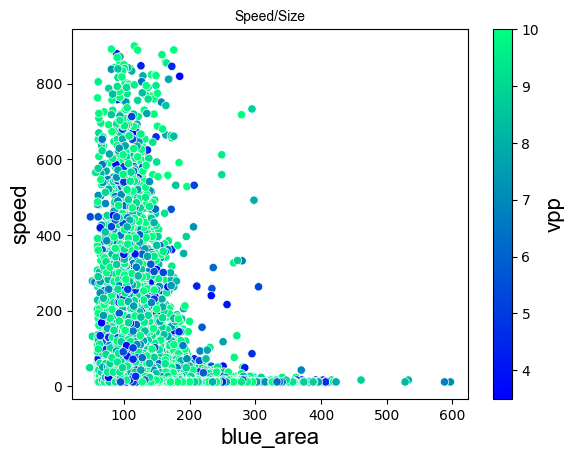

In [342]:
from scipy.optimize import curve_fit
from matplotlib.colors import Normalize
import matplotlib.cm as cm

df = df5
df = df[df["speed"] > 0]
df = df[df["speed"] < 900]
df = df[df["blue_area"] > 10]

x="blue_area"
y="speed"
hue="vpp"

# Prepare data for fitting
x_data = df[df["speed"] < 1600]["speed"]
y_data = df[df["speed"] < 1600]["blue_area"]

# Initial guess for the parameters
initial_guess = [1, 1]

# Fit the hyperbolic function to the data
# popt, pcov = curve_fit(hyperbola, x_data, y_data, p0=initial_guess)

# Plot the scatter plot and the fitted hyperbola
fig, ax = plt.subplots()
scatter = sns.scatterplot(df[df["speed"] < 1600], x=x, y=y, hue=hue, palette="winter", ax=ax, )
x_fit = np.linspace(min(x_data), max(x_data), 1000)
y_fit = hyperbola(x_fit, 50000, -50, 100)
# ax.plot(x_fit, y_fit, color='darkred', linewidth=2, linestyle='-', )

# Create a colorbar
norm = Normalize(vmin=df[hue].min(), vmax=df[hue].max())
sm = plt.cm.ScalarMappable(cmap="winter", norm=norm)
sm.set_array([])  # Only needed for matplotlib < 3.1

# Add the colorbar to the plot
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label(hue, size=16, font="arial")
ax.legend_.remove()

# Set logarithmic scale
# ax.set_xscale('log')
# ax.set_yscale('log')

ax.set_title('Speed/Size', size=28, font="arial")
ax.set_xlabel(x, size=16, font="arial")
ax.set_ylabel(y, size=16, font="arial")
# plt.savefig("speed_size_vpp_vascular.png", dpi=300)
plt.show()
# sns.scatterplot(df[df["speed"] < 1600 ], x="speed", y="blue_area", hue="piezo", )

In [345]:
df5.to_csv("out.csv")

In [263]:
# Define the hyperbolic function
def hyperbola(x, a, b, k):
    return a / (x-b) + k

C:\Users\loren\AppData\Local\Temp\ipykernel_24064\934957731.py:29: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(labels[::-1])
C:\Users\loren\AppData\Local\Temp\ipykernel_24064\934957731.py:31: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.ax.set_yticklabels([f"{int(t)}" for t in cbar.get_ticks()], font="arial", size=12)
C:\Users\loren\AppData\Local\Temp\ipykernel_24064\934957731.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar.ax.set_yticklabels([f"{int(t)}" for t in cbar.get_ticks()], font="arial", size=12)


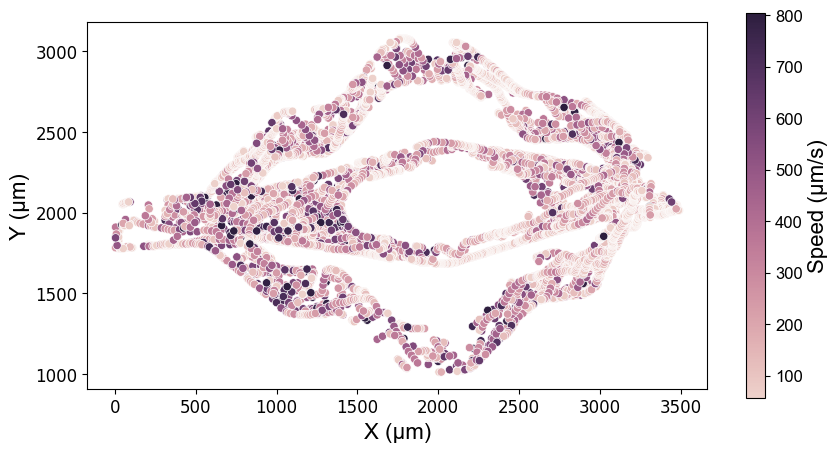

In [102]:
import matplotlib.colors as colors

df = df4
df = df[df["speed"] > 0]
plt.figure(figsize=(10, 5))
ax = sns.scatterplot(df[df["speed"] < 810], x="agent_location_x", y="agent_location_y", hue="speed", ) # hue_norm=colors.LogNorm())
# ax.set_title('Speed/Location', size=28, font="arial")
ax.set_xlabel("X (µm)", size=16, font="arial")  # µm is the symbol for micrometers
ax.set_ylabel("Y (µm)", size=16, font="arial")
ax.legend_.remove()
ax.invert_yaxis()
ax.set_aspect('equal')
norm = plt.Normalize(df[df['speed']<810]['speed'].min(), df[df['speed']<810]['speed'].max())
# norm = colors.LogNorm(df[df['speed']<100]['speed'].min(), df[df['speed']<100]['speed'].max())
cmap = sns.cubehelix_palette(as_cmap=True)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# ax.set_xticks(range(0, 170, 20))
# ax.set_yticks(range(39, 140, 20))

# ax.set_xticklabels(range(0, 170, 20), font="arial", size=12)
# ax.set_yticklabels(range(140, 39, -20), font="arial", size=12)

# Get current y-axis labels
labels = [item.get_text() for item in ax.get_yticklabels()]

# Reverse the order of the labels and set them back
ax.set_yticklabels(labels[::-1])

cbar.ax.set_yticklabels([f"{int(t)}" for t in cbar.get_ticks()], font="arial", size=12)

ax.tick_params(labelsize=12)
cbar = plt.colorbar(mappable=sm, ax=ax)
cbar.set_label("Speed (µm/s)", size=16, font="arial")
cbar.ax.tick_params(labelsize=12)
cbar.ax.set_yticklabels([f"{int(t)}" for t in cbar.get_ticks()], font="arial", size=12)

plt.savefig("speed_location_vascular_2.png", dpi=300)

x    500.041999
y    303.611027
dtype: float64
x    231.577195
y    443.076074
dtype: float64
x    624.520166
y    443.176729
dtype: float64
x    286.070815
y    423.201717
dtype: float64


C:\Users\Elisa\AppData\Local\Temp\ipykernel_14020\3377664066.py:35: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.text(cluster_center[0], cluster_center[1],
C:\Users\Elisa\AppData\Local\Temp\ipykernel_14020\3377664066.py:35: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.text(cluster_center[0], cluster_center[1],
C:\Users\Elisa\AppData\Local\Temp\ipykernel_14020\3377664066.py:35: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  

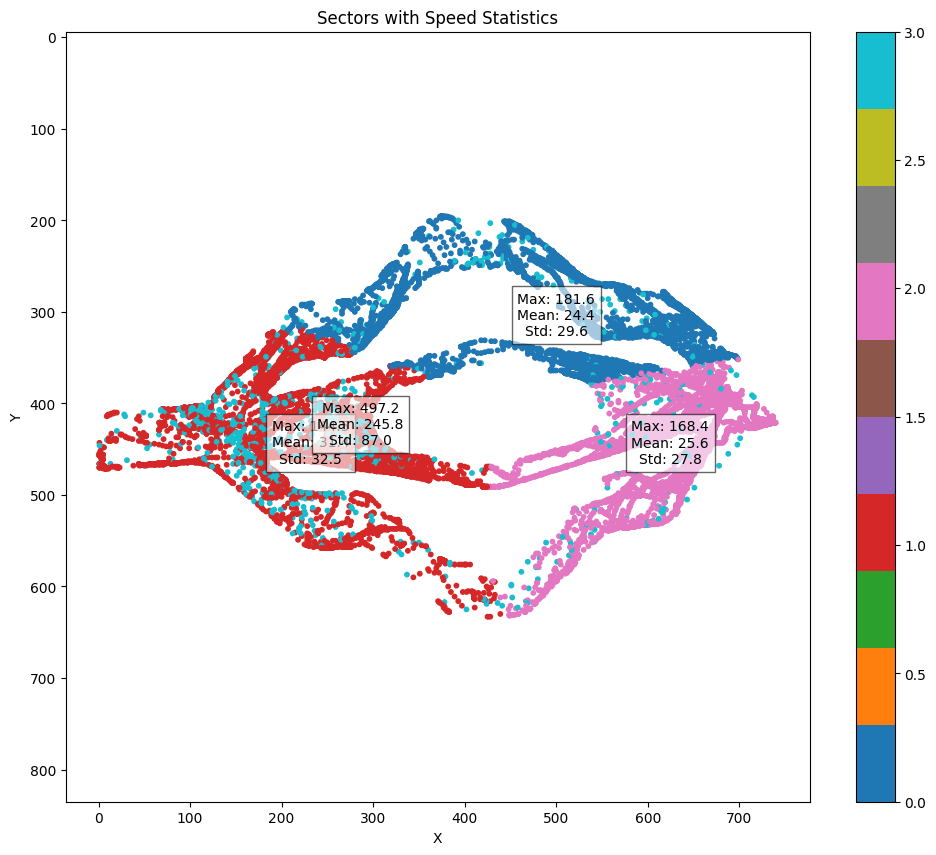

In [226]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import StandardScaler

df = df4[df4["speed"] < 500]
x = df["agent_location_x"]
y = df["agent_location_y"]
speed = df["speed"]
coords = np.stack((x,y,), axis=-1)
scaler = StandardScaler()
coords_ = scaler.fit_transform(coords)

n_clusters = 4  # Adjust the number of sectors
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(coords_)
labels = kmeans.labels_

data = pd.DataFrame({'x': x, 'y': y, 'speed': speed})
data['cluster'] = kmeans.labels_ #kmeans.predict(data[['x', 'y']])

cluster_stats = data.groupby('cluster').agg({
    'speed': ['max', 'mean', 'std']
}).reset_index()

plt.figure(figsize=(12, 10))
plt.scatter(coords[:, 0], coords[:, 1], c=labels, cmap='tab10', s=10)
plt.gca().invert_yaxis()

# Annotate the statistics
for i in range(n_clusters):
    cluster_center = np.mean(data.loc[data["cluster"]==i, ["x", "y"]], axis=0)
    print(cluster_center)
    max_speed = cluster_stats.loc[i, ('speed', 'max')]
    mean_speed = cluster_stats.loc[i, ('speed', 'mean')]
    std_speed = cluster_stats.loc[i, ('speed', 'std')]
    plt.text(cluster_center[0], cluster_center[1], 
             f'Max: {max_speed:.1f}\nMean: {mean_speed:.1f}\nStd: {std_speed:.1f}', 
             ha='center', va='center', fontsize=10, bbox=dict(facecolor='white', alpha=0.6))

plt.title('Sectors with Speed Statistics')
plt.xlabel('X')
plt.ylabel('Y')
plt.axis("equal")
plt.colorbar()
plt.show()


C:\Users\Elisa\AppData\Local\Temp\ipykernel_14020\592308774.py:1: FutureWarning: The provided callable <function mean at 0x000001CC90027A60> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  pivot_table = df4[df4["speed"] < 300].pivot_table(values='speed', index='agent_location_y', columns='agent_location_x', aggfunc=np.mean)


agent_location_x,1,2,3,4,5,6,7,8,9,10,...,730,731,732,733,734,735,736,737,739,740
agent_location_y,,,,,,,,,,,,,,,,,,,,,
196,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
197,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
198,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
201,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
628,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
630,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
631,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


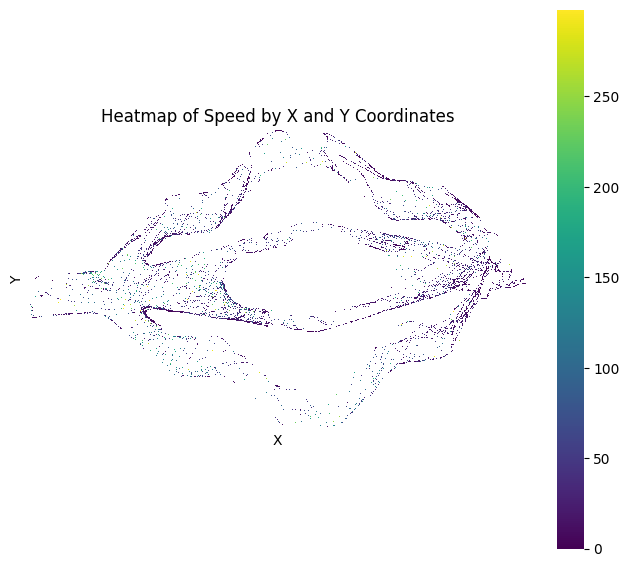

In [227]:
pivot_table = df4[df4["speed"] < 300].pivot_table(values='speed', index='agent_location_y', columns='agent_location_x', aggfunc=np.mean)
plt.figure(figsize=(8, 7))
sns.heatmap(pivot_table, cmap='viridis', square=True, xticklabels=False, yticklabels=False)
plt.title('Heatmap of Speed by X and Y Coordinates')
plt.xlabel('X')
plt.ylabel('Y')

pivot_table

In [30]:
from scipy.interpolate import griddata
df = df3[df3["speed"] < 300]
n = df["speed"].count()

x = df["agent_location_x"]
y = df["agent_location_y"]
speed = df["speed"]

# Create a grid for interpolation
x_max, x_min = x.max(), x.min()
y_max, y_min = y.max(), y.min()
grid_x, grid_y = np.mgrid[x_min-50:x_max+50:1, y_min-50:y_max+50:1]

print(x_max, y_max, x_min, y_min)

# Interpolate the data
grid_speed = griddata((x, y), speed, (grid_x, grid_y), method='nearest', rescale=True)

# Fill the empty areas with the nearest neighbor interpolation
# grid_speed = np.nan_to_num(grid_speed,)#  nan=np.nanmean(grid_speed))

# Plot the heatmap with interpolated data
plt.figure(figsize=(10, 8))
gridmap = plt.imshow(grid_speed.T, origin='lower', cmap='viridis', aspect='auto')
plt.colorbar(label='Speed')
plt.title('Smoothed Heatmap of Speed by X and Y Coordinates')
plt.xlabel('X')
plt.ylabel('Y')
plt.gca().set_aspect('equal', adjustable='box')
gridmap.set_array(np.ma.masked_invalid(gridmap.get_array()))
plt.show()

797 633 3 194


702 417


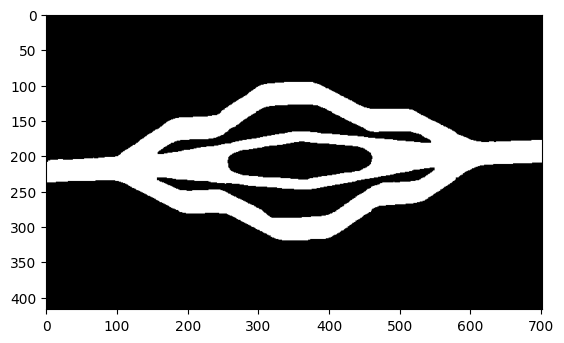

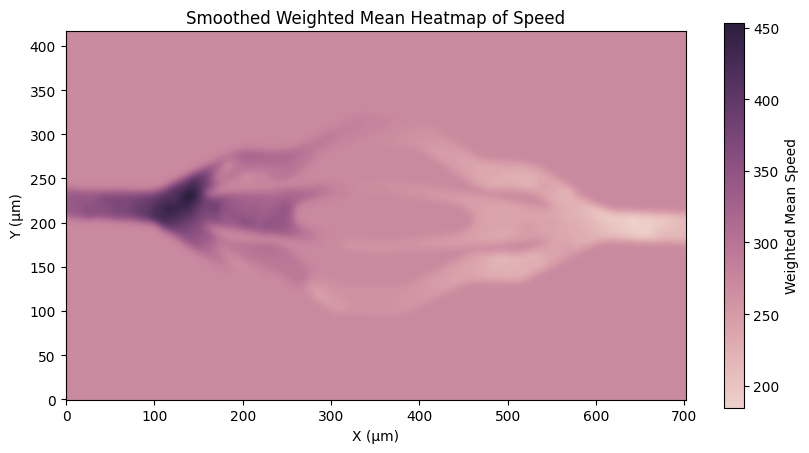

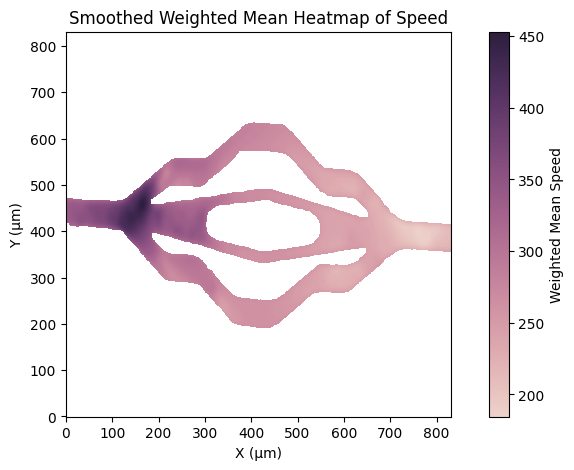

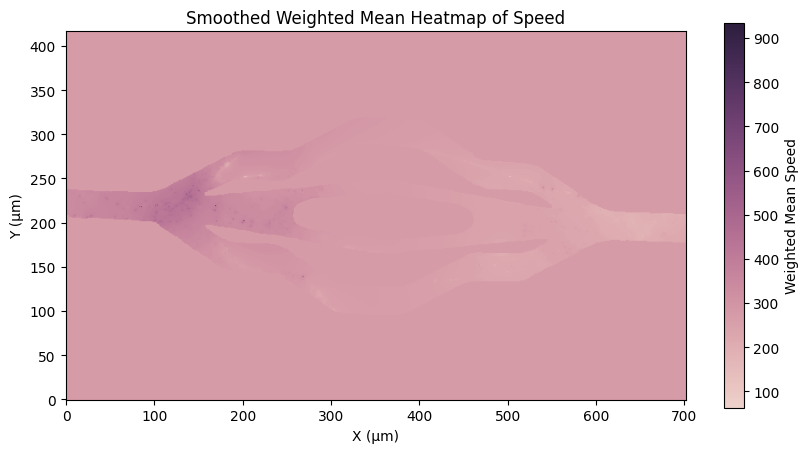

In [119]:
from scipy.interpolate import griddata
from scipy.ndimage import gaussian_filter

df = df4
n = df["speed"].count()
cmap = sns.cubehelix_palette(as_cmap=True)

x = df["agent_location_x"]
y = df["agent_location_y"]
speed = df["speed"]
mean_speed = np.mean(speed)

res = 5
x_max, x_min = x.max(), x.min()
y_max, y_min = y.max(), y.min()

grid_x, grid_y = np.mgrid[x_min-10:x_max+10:res, y_min-10:y_max+10:res]

# Normalize the coordinates to the mask size
# x_normalized = ((x - x.min()) / (x.max() - x.min()) * (mask.shape[1] - 1)).astype(int)
# y_normalized = ((y - y.min()) / (y.max() - y.min()) * (mask.shape[0] - 1)).astype(int)

weighted_mean_grid = np.ones((len(grid_x), len(grid_y[0])))*mean_speed
print(len(grid_x), len(grid_y[0]))

mask_ = mask_vasc.resize(weighted_mean_grid.shape, Image.Resampling.NEAREST)
mask_ = np.array(mask_)
plt.imshow(mask_)
plt.show()

# Calculate weighted mean for each grid point
for i in range(len(grid_x)):
    for j in range(len(grid_y[0])):
        if mask_[j, i, 0] < 1:
            continue
        # Calculate distances from the grid point to all data points
        distances = np.power((grid_x[i, j] - x)**2 + (grid_y[i, j] - y)**2, 1/2)
        # Compute weights (inverse of distances, adding a small value to avoid division by zero)
        weights = 1 / (distances + 1e-5)
        # Calculate weighted mean velocity
        weighted_mean_grid[i, j] += np.sum(weights * (-mean_speed+speed)) / np.sum(weights)

# Apply Gaussian filter to smooth the data
sigma=4.5  # Adjust sigma for the desired level of smoothing
weighted_mean_grid_1 = gaussian_filter(weighted_mean_grid, sigma=sigma)

# mask = mask_vasc.resize((weighted_mean_grid.shape), Image.Resampling.BILINEAR)
mask = np.array(mask_vasc)
x_dim = mask.shape[0]
y_dim = mask.shape[1]
weighted_mean_grid_2 = np.array(Image.fromarray(weighted_mean_grid_1).resize((x_dim, y_dim), Image.LANCZOS))
weighted_mean_grid_2[mask[:,:,0].T < 1] = np.nan

# Plot the smoothed weighted mean heatmap
plt.figure(figsize=(10, 5))
plt.imshow(weighted_mean_grid_1.T, origin='lower', cmap=cmap, aspect='auto')
plt.colorbar(label='Weighted Mean Speed')
plt.gca().set_aspect('equal',)
plt.title('Smoothed Weighted Mean Heatmap of Speed')
plt.xlabel("X (µm)")
plt.ylabel("Y (µm)")
plt.show()

plt.figure(figsize=(10, 5))
plt.imshow(weighted_mean_grid_2.T, origin='lower', cmap=cmap, aspect='auto')
plt.colorbar(label='Weighted Mean Speed')
plt.gca().set_aspect('equal',)
plt.title('Smoothed Weighted Mean Heatmap of Speed')
plt.xlabel("X (µm)")
plt.ylabel("Y (µm)")
plt.show()

plt.figure(figsize=(10, 5))
plt.imshow(weighted_mean_grid.T, origin='lower', cmap=cmap, aspect='auto')
plt.colorbar(label='Weighted Mean Speed')
plt.gca().set_aspect('equal',)
plt.title('Smoothed Weighted Mean Heatmap of Speed')
plt.xlabel("X (µm)")
plt.ylabel("Y (µm)")
plt.show()

# plt.imsave(weighted_mean_grid_1, "out_1.png")
# plt.imsave(weighted_mean_grid, "out_2.png")

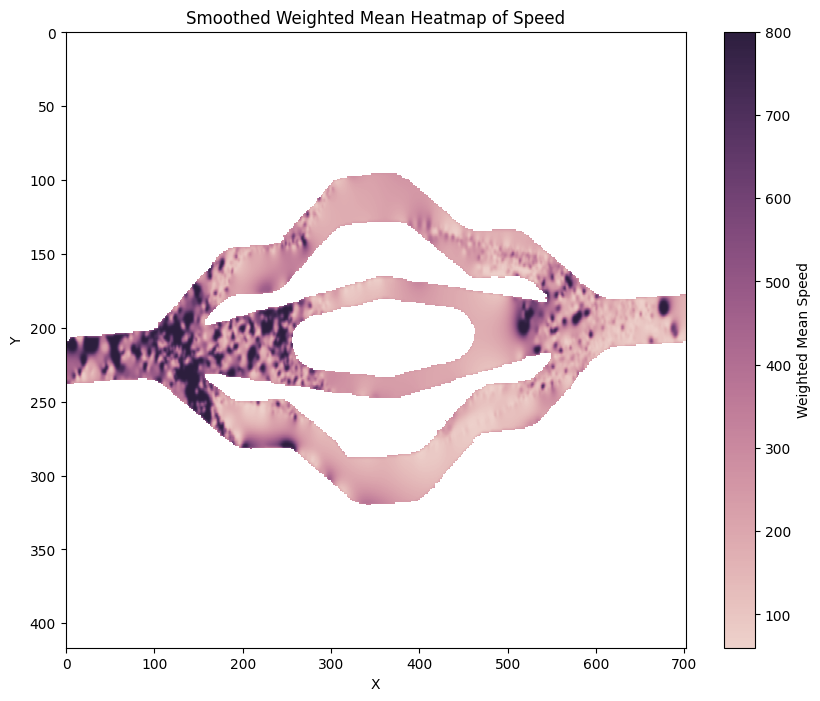

In [118]:
weighted_mean_grid_clipped = np.clip(weighted_mean_grid, 0, 800)
sigma=1.
weighted_mean_grid_clipped = gaussian_filter(weighted_mean_grid_clipped, sigma=sigma)
cmap = sns.cubehelix_palette(as_cmap=True)

# mask = np.array(mask_vasc)
mask = np.array(mask_vasc.resize(weighted_mean_grid_clipped.shape, Image.LANCZOS))
x_dim = mask.shape[0]
y_dim = mask.shape[1]
weighted_mean_grid_clipped = np.array(Image.fromarray(weighted_mean_grid_clipped).resize((x_dim, y_dim), Image.LANCZOS))
weighted_mean_grid_clipped[mask[:,:,0].T < 1] = np.nan

plt.figure(figsize=(10, 8))
plt.imshow(weighted_mean_grid_clipped.T, origin='upper', cmap=cmap, aspect='auto')
plt.colorbar(label='Weighted Mean Speed')
# plt.gca().set_aspect('equal', adjustable="box")
plt.title('Smoothed Weighted Mean Heatmap of Speed')
plt.xlabel('X')
plt.ylabel('Y')
# plt.savefig("speed_heatmap_12.png", dpi=300)
plt.show()

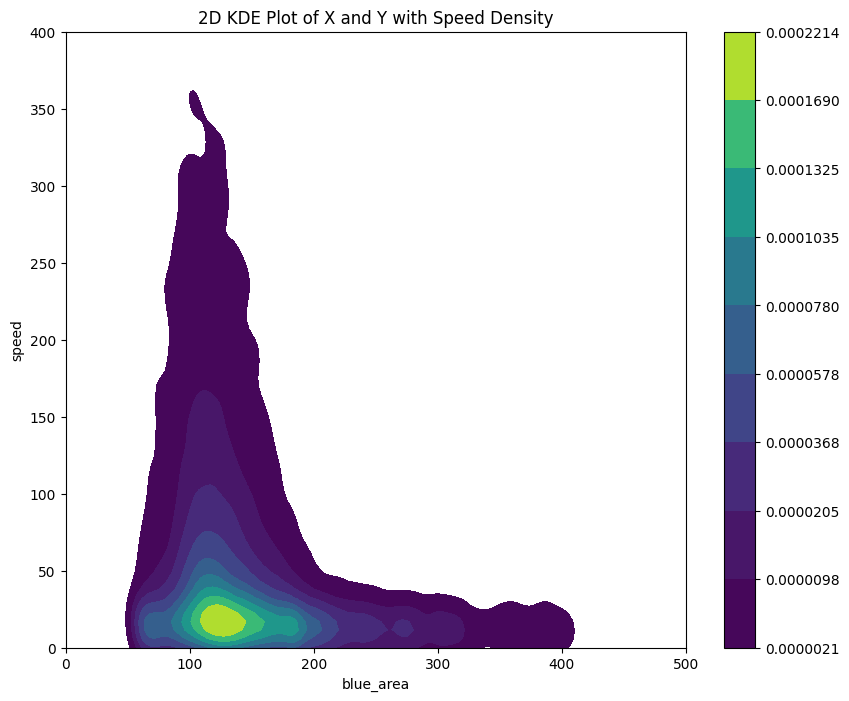

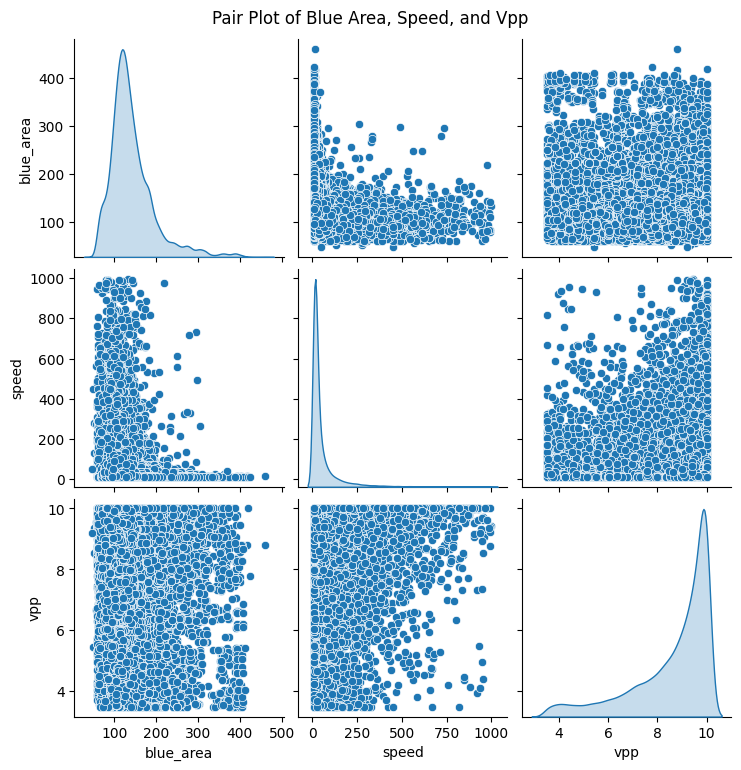

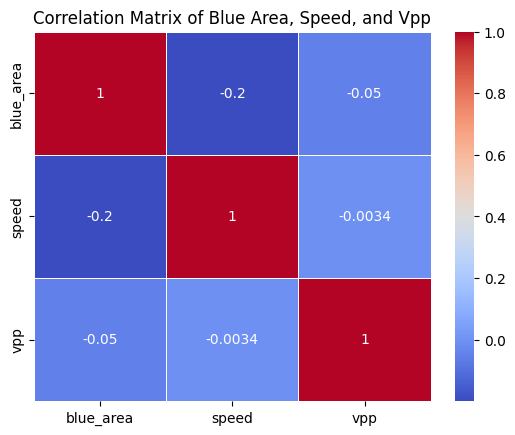

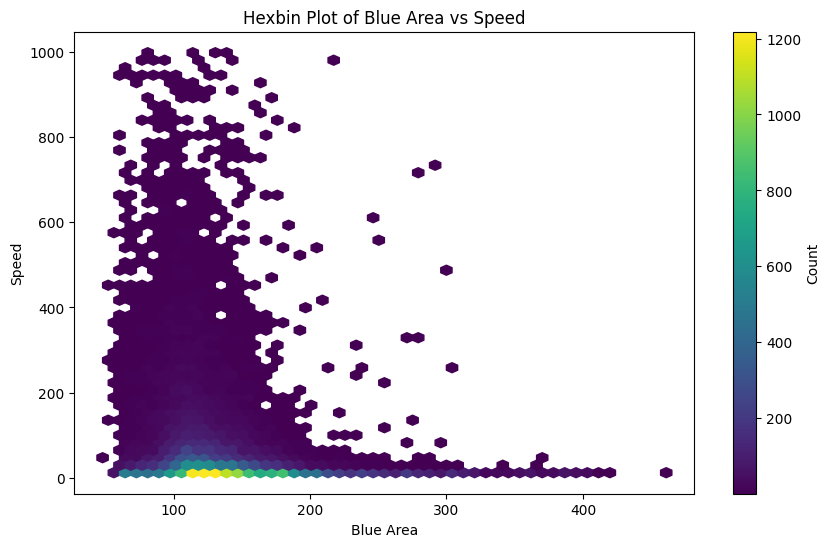

In [377]:
df = df5
df = df[df["speed"] < 1000]
df = df[df["speed"] > 10]
df = df[df["blue_area"] < 500]
df = df[df["blue_area"] > 10]

x="blue_area"
y="speed"

# df = df.sample(n=10)

# Create a 2D KDE plot
plt.figure(figsize=(10, 8))
sns.kdeplot(data=df, x=x, y=y, cmap='viridis', cbar=True, fill=True, bw_adjust=0.6)
plt.title('2D KDE Plot of X and Y with Speed Density')
plt.xlim((0, 500))
plt.ylim((0, 400))
plt.xlabel(x)
plt.ylabel(y)
plt.show()

sns.pairplot(df, vars=['blue_area', 'speed', 'vpp'], kind='scatter', diag_kind='kde')
plt.suptitle('Pair Plot of Blue Area, Speed, and Vpp', y=1.02)
plt.show()

correlation_matrix = df[['blue_area', 'speed', 'vpp']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix of Blue Area, Speed, and Vpp')
plt.show()

# g = sns.FacetGrid(df, col='vpp', col_wrap=4, height=4)
# g.map(sns.scatterplot, 'blue_area', 'speed', alpha=0.7)
# g.add_legend()
# plt.subplots_adjust(top=0.9)
# g.fig.suptitle('Scatter Plots of Blue Area vs Speed, Faceted by Vpp')
# plt.show()

plt.figure(figsize=(10, 6))
plt.hexbin(df['blue_area'], df['speed'], gridsize=50, cmap='viridis', mincnt=1)
plt.colorbar(label='Count')
plt.xlabel('Blue Area')
plt.ylabel('Speed')
plt.title('Hexbin Plot of Blue Area vs Speed')
plt.show()

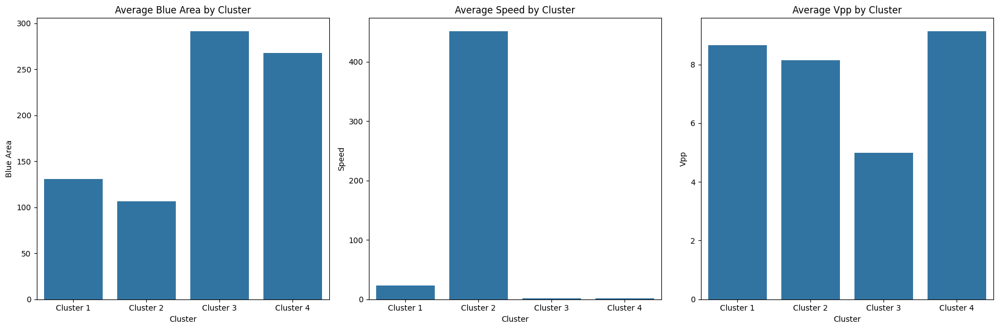

In [363]:
# Filter out rows where speed, blue_area, or vpp are NaN
filtered_data = df.dropna(subset=['speed', 'blue_area', 'vpp'])

# Convert columns to numeric, forcing non-numeric values to NaN
filtered_data['blue_area'] = pd.to_numeric(filtered_data['blue_area'], errors='coerce')
filtered_data['speed'] = pd.to_numeric(filtered_data['speed'], errors='coerce')
filtered_data['vpp'] = pd.to_numeric(filtered_data['vpp'], errors='coerce')

# Drop any remaining NaN values after conversion
filtered_data = filtered_data.dropna(subset=['blue_area', 'speed', 'vpp'])

# Define custom ranges for clustering
def assign_cluster(row):
    if row['blue_area'] < 200:
        if row['speed'] < 300:
            return 'Cluster 1'
        else:
            return 'Cluster 2'
    else:
        if row['vpp'] < 7:
            return 'Cluster 3'
        else:
            return 'Cluster 4'

filtered_data['cluster'] = filtered_data.apply(assign_cluster, axis=1)

# Visualize the clusters using bar plots
cluster_means = filtered_data.groupby('cluster').mean()

# Plot bar plots for each feature by cluster
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
sns.barplot(x=cluster_means.index, y=cluster_means['blue_area'], ax=axes[0])
axes[0].set_title('Average Blue Area by Cluster')
axes[0].set_xlabel('Cluster')
axes[0].set_ylabel('Blue Area')

sns.barplot(x=cluster_means.index, y=cluster_means['speed'], ax=axes[1])
axes[1].set_title('Average Speed by Cluster')
axes[1].set_xlabel('Cluster')
axes[1].set_ylabel('Speed')

sns.barplot(x=cluster_means.index, y=cluster_means['vpp'], ax=axes[2])
axes[2].set_title('Average Vpp by Cluster')
axes[2].set_xlabel('Cluster')
axes[2].set_ylabel('Vpp')

plt.tight_layout()
plt.show()

In [33]:
print(grid_speed.shape)

(200, 200)


TypeError: Image data of dtype object cannot be converted to float

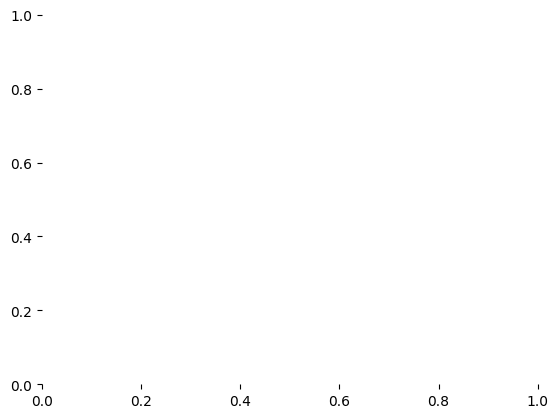

In [89]:
sns.heatmap(df2[df2["speed"]< 300], x="agent_location_x", y="agent_location_y", hue="speed")

<Axes: xlabel='speed', ylabel='blue_area'>

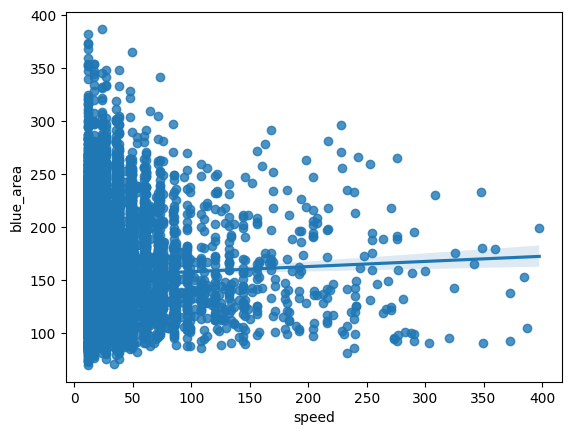

In [83]:
sns.regplot(df, x="speed", y="blue_area",)

<Axes: xlabel='blue_area', ylabel='speed'>

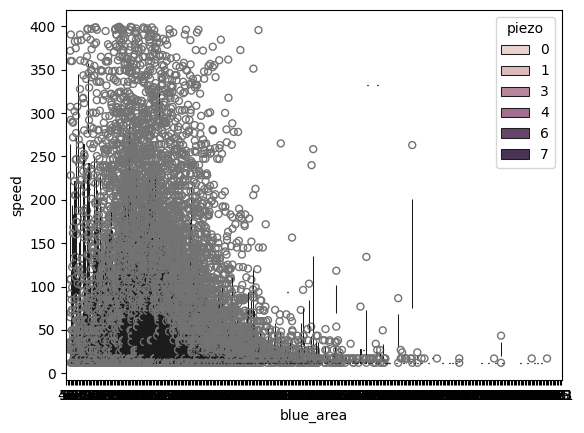

In [378]:
# plt.figure(figsize=(35, 6))
df = df5
df["blue_area_range"] = pd.cut()
sns.boxenplot(df[df["speed"] < 400], y="speed", x="blue_area_range", hue="vpp_range")

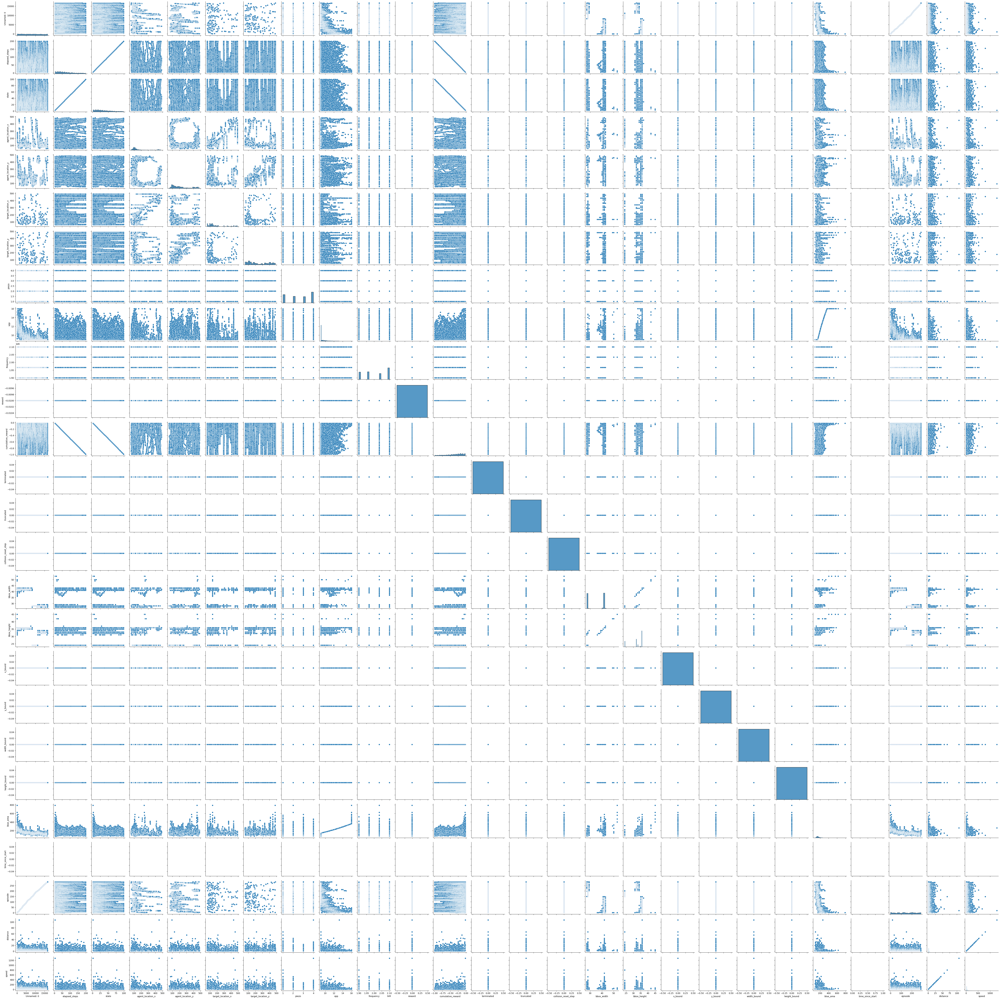

In [30]:
plot = sns.pairplot(df, hue="piezo")
fig = plot.get_figure()
fig.save_fig("out.png")


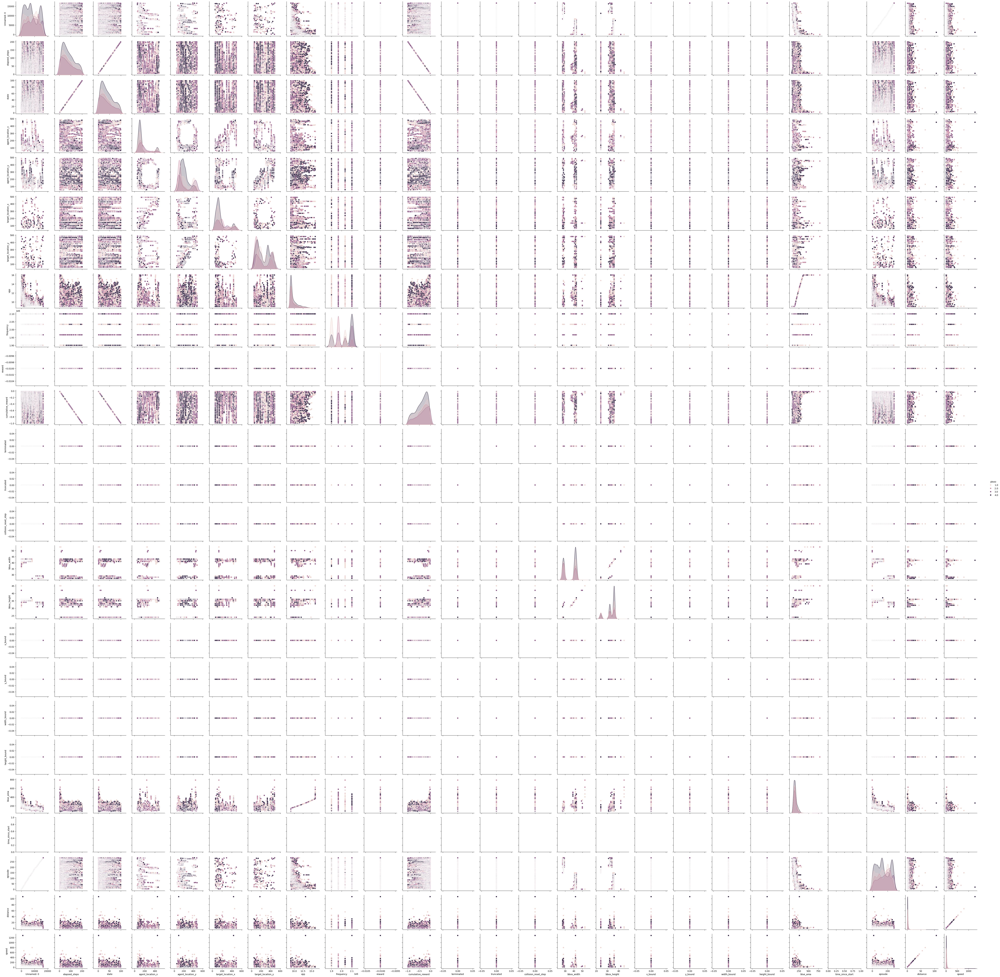

In [32]:
plot = sns.pairplot(df, hue="piezo")
# fig = plot.get_figure()
# fig.save_fig("out.png")

Text(0.5, 0, 'Speed')

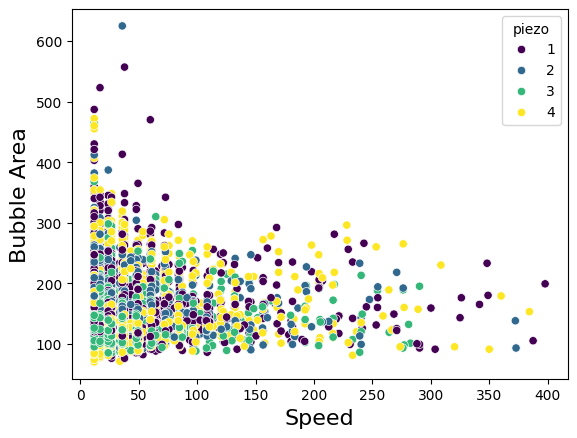

In [20]:
ax = sns.scatterplot(df, x="speed", y="blue_area", hue="piezo", palette="viridis")
ax.set_ylabel("Bubble Area", {"size": 16})
ax.set_xlabel("Speed", {"size": 16})